# I. Processamento de Sinais e Classificação Automático

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as ss
import scipy.io.wavfile as wav
from IPython.display import Audio, display

# II. Filtragem

In [8]:
def filtroFBCF(x, g, N):
    
    aK = np.zeros(N)
    bK = np.ones(1)
    
    aK[0] = 1
    aK[N - 1] = -g
    
    return ss.lfilter(bK, aK, x)

def filtroAP(x, g, N):
    
    aK = np.zeros(N)
    bK = np.zeros(N)
    
    aK[0] = 1
    aK[N - 1] = -g
    
    bK[0] = -g
    bK[N - 1] = 1
    
    return ss.lfilter(bK, aK, x)

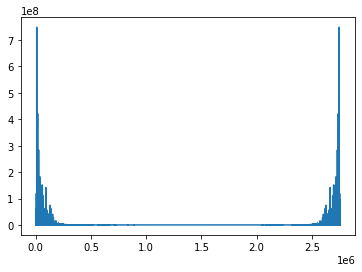

In [9]:
rate, x = wav.read("GuitarSound.wav")
frequencia = np.fft.fft(x[:,0])
plt.plot(np.abs(frequencia))

display(Audio(data=x[:,0], rate=rate))

x = x[:,0]
y1 = filtroFBCF(x, 0.773, 1687) + filtroFBCF(x, 0.802, 1601) + filtroFBCF(x, 0.753, 2053) + filtroFBCF(x, 0.733, 2251)
y2 = filtroAP(y1, 0.7, 347)
y3 = filtroAP(y2, 0.7, 113)

display(Audio(data=y3, rate=rate))

In [13]:
y1 = filtroFBCF(x, 0.25, 2100) + filtroFBCF(x, 0.25, 2400) + filtroFBCF(x, 0.25, 2800) + filtroFBCF(x, 0.25, 3200)
y2 = filtroAP(y1, 0.25, 1000)
y3 = filtroAP(y2, 0.25, 750)

display(Audio(data=y3, rate=rate))